# Installing & Importing Libraries

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install keract
import keract

In [3]:
import pickle
import numpy as np
import pandas as pd
from PIL import Image
import albumentations as A
from IPython.display import SVG
import matplotlib.pyplot as plt
%matplotlib inline
import os, re, sys, random, shutil, cv2

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, Nadam
from tensorflow.keras import applications, optimizers
from tensorflow.keras.applications.resnet50 import preprocess_input

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import model_to_dot, plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, CSVLogger, LearningRateScheduler
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, ZeroPadding2D, Dropout

# Working with Augmented Dataset

In [4]:
# train_images = "../input/augmented-dubai-aerial-imagery-dataset/train_images/"
# train_masks = "../input/augmented-dubai-aerial-imagery-dataset/train_masks/"
# val_images = "../input/augmented-dubai-aerial-imagery-dataset/val_images/"
# val_masks = "../input/augmented-dubai-aerial-imagery-dataset/val_masks/"
train_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_images/"
train_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_masks/"
val_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_images/"
val_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_masks/"

In [5]:
file_names = np.sort(os.listdir(train_images + 'train/'))
file_names = np.char.split(file_names, '.')
filenames = np.array([])
for i in range(len(file_names)):
    filenames = np.append(filenames, file_names[i][0])

In [6]:
# def show_data(files, original_images_dir, label_images_dir):

#     for file in files:
#         fig, axs = plt.subplots(1, 2, figsize=(15, 6), constrained_layout=True)

#         axs[0].imshow(cv2.resize(cv2.imread(original_images_dir+'train/'+str(file)+'.jpg'), (2000,1400)))
#         axs[0].set_title('Original Image', fontdict = {'fontsize':14, 'fontweight': 'medium'})
#         axs[0].set_xticks(np.arange(0, 2001, 200))
#         axs[0].set_yticks(np.arange(0, 1401, 200))
#         axs[0].grid(False)
#         axs[0].axis(True)

#         semantic_label_image = cv2.imread(label_images_dir+ 'train/'+str(file)+'.png')
#         semantic_label_image = cv2.cvtColor(semantic_label_image, cv2.COLOR_BGR2RGB)
#         semantic_label_image = cv2.resize(semantic_label_image, (2000,1400))
#         axs[1].imshow(semantic_label_image)
#         axs[1].set_title('Semantic Segmentation Mask', fontdict = {'fontsize':14, 'fontweight': 'medium'})
#         axs[1].set_xticks(np.arange(0, 2001, 200))
#         axs[1].set_yticks(np.arange(0, 1401, 200))
#         axs[1].grid(False)
#         axs[1].axis(True)

#         plt.savefig('./sample_'+file, facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 100)
#         plt.show()


# files = ['image_t4_003', 'image_t4_005', 'image_t6_002', 'image_t7_002', 'image_t8_003', 'image_t8_004', 'image_t8_006']
# show_data(files, train_images, train_masks)

In [7]:
import numpy as np
import pandas as pd

# Define class colors
class_building = '#3C1098'
class_building = class_building.lstrip('#')
class_building = np.array(tuple(int(class_building[i:i+2], 16) for i in (0,2,4)))

class_land = '#8429F6'
class_land = class_land.lstrip('#')
class_land = np.array(tuple(int(class_land[i:i+2], 16) for i in (0,2,4)))

class_road = '#6EC1E4'
class_road = class_road.lstrip('#')
class_road = np.array(tuple(int(class_road[i:i+2], 16) for i in (0,2,4)))

class_vegetation = '#FEDD3A'
class_vegetation = class_vegetation.lstrip('#')
class_vegetation = np.array(tuple(int(class_vegetation[i:i+2], 16) for i in (0,2,4)))

class_water = '#E2A929'
class_water = class_water.lstrip('#')
class_water = np.array(tuple(int(class_water[i:i+2], 16) for i in (0,2,4)))

class_unlabeled = '#9B9B9B'
class_unlabeled = class_unlabeled.lstrip('#')
class_unlabeled = np.array(tuple(int(class_unlabeled[i:i+2], 16) for i in (0,2,4)))

# Create DataFrame
data = {
    'name': ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'],
    'r': [class_building[0], class_land[0], class_road[0], class_vegetation[0], class_water[0], class_unlabeled[0]],
    'g': [class_building[1], class_land[1], class_road[1], class_vegetation[1], class_water[1], class_unlabeled[1]],
    'b': [class_building[2], class_land[2], class_road[2], class_vegetation[2], class_water[2], class_unlabeled[2]]
}

df = pd.DataFrame(data)

# Save DataFrame to CSV
df.to_csv('class_colors.csv', index=False)


In [8]:
class_dict_df = pd.read_csv('/content/class_colors.csv', index_col=False, skipinitialspace=True)
class_dict_df

,name,r,g,b
0,building,60,16,152
1,land,132,41,246
2,road,110,193,228
3,vegetation,254,221,58
4,water,226,169,41
5,unlabeled,155,155,155


In [9]:
label_names= list(class_dict_df.name)
label_codes = []
r= np.asarray(class_dict_df.r)
g= np.asarray(class_dict_df.g)
b= np.asarray(class_dict_df.b)

for i in range(len(class_dict_df)):
    label_codes.append(tuple([r[i], g[i], b[i]]))

label_codes, label_names

([(60, 16, 152),
  (132, 41, 246),
  (110, 193, 228),
  (254, 221, 58),
  (226, 169, 41),
  (155, 155, 155)],
 ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'])

# Create Useful Label & Code Conversion Dictionaries

These will be used for:

* One hot encoding the mask labels for model training
* Decoding the predicted labels for interpretation and visualization

In [10]:
code2id = {v:k for k,v in enumerate(label_codes)}
id2code = {k:v for k,v in enumerate(label_codes)}

name2id = {v:k for k,v in enumerate(label_names)}
id2name = {k:v for k,v in enumerate(label_names)}

In [11]:
id2code

{0: (60, 16, 152),
 1: (132, 41, 246),
 2: (110, 193, 228),
 3: (254, 221, 58),
 4: (226, 169, 41),
 5: (155, 155, 155)}

In [12]:
id2name

{0: 'building',
 1: 'land',
 2: 'road',
 3: 'vegetation',
 4: 'water',
 5: 'unlabeled'}

# Define Functions for One Hot Encoding RGB Labels & Decoding Encoded Predictions

In [13]:
def rgb_to_onehot(rgb_image, colormap = id2code):
    '''Function to one hot encode RGB mask labels
        Inputs:
            rgb_image - image matrix (eg. 256 x 256 x 3 dimension numpy ndarray)
            colormap - dictionary of color to label id
        Output: One hot encoded image of dimensions (height x width x num_classes) where num_classes = len(colormap)
    '''
    num_classes = len(colormap)
    shape = rgb_image.shape[:2]+(num_classes,)
    encoded_image = np.zeros( shape, dtype=np.int8 )
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(rgb_image.reshape( (-1,3) ) == colormap[i], axis=1).reshape(shape[:2])
    return encoded_image


def onehot_to_rgb(onehot, colormap = id2code):
    '''Function to decode encoded mask labels
        Inputs:
            onehot - one hot encoded image matrix (height x width x num_classes)
            colormap - dictionary of color to label id
        Output: Decoded RGB image (height x width x 3)
    '''
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

# Creating Custom Image Data Generators
## Defining Data Generators

In [14]:
# Normalizing only frame images, since masks contain label info
data_gen_args = dict(rescale=1./255)
mask_gen_args = dict()

train_frames_datagen = ImageDataGenerator(**data_gen_args)
train_masks_datagen = ImageDataGenerator(**mask_gen_args)
val_frames_datagen = ImageDataGenerator(**data_gen_args)
val_masks_datagen = ImageDataGenerator(**mask_gen_args)

# Seed defined for aligning images and their masks
seed = 1

# Custom Image Data Generators for Creating Batches of Frames and Masks

In [15]:
def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed=1, batch_size=8, target_size=(512, 512)):
    train_image_generator = train_frames_datagen.flow_from_directory(
        train_images_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    train_mask_generator = train_masks_datagen.flow_from_directory(
        train_masks_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    while True:
        X1i = train_image_generator.next()
        X2i = train_mask_generator.next()

        # One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x, :, :, :], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)


def ValAugmentGenerator(val_images_dir, val_masks_dir, seed=1, batch_size=8, target_size=(512, 512)):
    val_image_generator = val_frames_datagen.flow_from_directory(
        val_images_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    val_mask_generator = val_masks_datagen.flow_from_directory(
        val_masks_dir,
        batch_size=batch_size,
        seed=seed,
        target_size=target_size
    )

    while True:
        X1i = val_image_generator.next()
        X2i = val_mask_generator.next()

        # One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x, :, :, :], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)


In [16]:
# def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
#     '''Train Image data generator
#         Inputs:
#             seed - seed provided to the flow_from_directory function to ensure aligned data flow
#             batch_size - number of images to import at a time
#             train_images_dir - train images directory
#             train_masks_dir - train masks directory
#             target_size - tuple of integers (height, width)

#         Output: Decoded RGB image (height x width x 3)
#     '''
#     train_image_generator = train_frames_datagen.flow_from_directory(
#     train_images_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)

#     train_mask_generator = train_masks_datagen.flow_from_directory(
#     train_masks_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)

#     while True:
#         X1i = train_image_generator.next()
#         X2i = train_mask_generator.next()

#         #One hot encoding RGB images
#         mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

#         yield X1i[0], np.asarray(mask_encoded)

# def ValAugmentGenerator(val_images_dir, val_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
#     '''Validation Image data generator
#         Inputs:
#             seed - seed provided to the flow_from_directory function to ensure aligned data flow
#             batch_size - number of images to import at a time
#             val_images_dir - validation images directory
#             val_masks_dir - validation masks directory
#             target_size - tuple of integers (height, width)

#         Output: Decoded RGB image (height x width x 3)
#     '''
#     val_image_generator = val_frames_datagen.flow_from_directory(
#     val_images_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)


#     val_mask_generator = val_masks_datagen.flow_from_directory(
#     val_masks_dir,
#     batch_size = batch_size,
#     seed = seed,
#     target_size = target_size)


#     while True:
#         X1i = val_image_generator.next()
#         X2i = val_mask_generator.next()

#         #One hot encoding RGB images
#         mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

#         yield X1i[0], np.asarray(mask_encoded)

# Model

In [17]:
batch_size = 16
num_train_samples = len(np.sort(os.listdir(train_images+'train')))
num_val_samples = len(np.sort(os.listdir(val_images+'val')))
steps_per_epoch = np.ceil(float(num_train_samples) / float(batch_size))
print('steps_per_epoch: ', steps_per_epoch)
validation_steps = np.ceil(float(4 * num_val_samples) / float(batch_size))
print('validation_steps: ', validation_steps)

steps_per_epoch:  35.0
validation_steps:  18.0


## MultiUNET

In [29]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPooling2D, UpSampling2D, Concatenate, Dropout

def conv_block(inputs, filters, kernel_size=(3, 3), activation='relu', padding='same'):
    x = Conv2D(filters, kernel_size, padding=padding)(inputs)
    x = BatchNormalization()(x)
    x = Activation(activation)(x)
    return x

def build_multiunet_model(input_shape, num_classes=6):
    inputs = Input(input_shape)

    # Encoder
    conv1 = conv_block(inputs, 64)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = conv_block(pool1, 128)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = conv_block(pool2, 256)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = conv_block(pool3, 512)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = conv_block(pool4, 1024)

    # Decoder
    up6 = UpSampling2D(size=(2, 2))(conv5)
    up6 = conv_block(up6, 512)
    merge6 = Concatenate()([conv4, up6])
    conv6 = conv_block(merge6, 512)

    up7 = UpSampling2D(size=(2, 2))(conv6)
    up7 = conv_block(up7, 256)
    merge7 = Concatenate()([conv3, up7])
    conv7 = conv_block(merge7, 256)

    up8 = UpSampling2D(size=(2, 2))(conv7)
    up8 = conv_block(up8, 128)
    merge8 = Concatenate()([conv2, up8])
    conv8 = conv_block(merge8, 128)

    up9 = UpSampling2D(size=(2, 2))(conv8)
    up9 = conv_block(up9, 64)
    merge9 = Concatenate()([conv1, up9])
    conv9 = conv_block(merge9, 64)

    # Output layer
    outputs = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = Model(inputs=inputs, outputs=outputs, name='simple_MultiUNet')
    return model


In [30]:
K.clear_session()

def dice_coef(y_true, y_pred):
    return (2. * K.sum(y_true * y_pred) + 1.) / (K.sum(y_true) + K.sum(y_pred) + 1.)

model = build_multiunet_model(input_shape=(512, 512, 3))
model.compile(optimizer=Adam(lr = 0.0001), loss='categorical_crossentropy', metrics=[dice_coef, "accuracy"])
model.summary()

Model: "simple_MultiUNet"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 512, 512, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 512, 512, 64)         256       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, 512, 512, 64)         0         ['batch_normali

### Model Layout

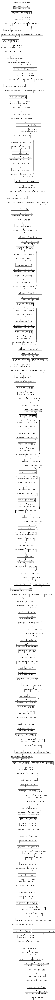

In [28]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True, expand_nested=True)

# Model Training

In [20]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import precision_score, recall_score, f1_score

class MetricsCallback(tf.keras.callbacks.Callback):
    def __init__(self, validation_data):
        super(MetricsCallback, self).__init__()
        self.validation_data = validation_data

    def on_epoch_end(self, epoch, logs=None):
        val_preds = self.model.predict(self.validation_data[0])
        val_true = self.validation_data[1]

        val_preds_argmax = np.argmax(val_preds, axis=-1)
        val_true_argmax = np.argmax(val_true, axis=-1)

        val_recall = recall_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_precision = precision_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_f1 = f1_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')

        print(f' - val_recall: {val_recall:.4f} - val_precision: {val_precision:.4f} - val_f1: {val_f1:.4f}')

In [21]:
val_data = next(ValAugmentGenerator(val_images_dir=val_images, val_masks_dir=val_masks, target_size=(512, 512)))

# Instantiate the MetricsCallback
metrics_callback = MetricsCallback(validation_data=val_data)

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.


In [31]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.0001, 60)

lr_scheduler = LearningRateScheduler(
    exponential_decay_fn,
    verbose=1
)

checkpoint = ModelCheckpoint(
    filepath = 'simple_MultiUNet.h5',
    save_best_only = True,
#     save_weights_only = False,
    monitor = 'val_loss',
    mode = 'auto',
    verbose = 1
)

earlystop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.001,
    patience = 12,
    mode = 'auto',
    verbose = 1,
    restore_best_weights = True
)

csvlogger = CSVLogger(
    filename= "model_training.csv",
    separator = ",",
    append = False
)

callbacks = [checkpoint, earlystop, csvlogger, lr_scheduler, metrics_callback]

In [32]:
history = model.fit(
    TrainAugmentGenerator(train_images_dir = train_images, train_masks_dir = train_masks, target_size = (512, 512)),
    steps_per_epoch=steps_per_epoch,
    validation_data = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512)),
    validation_steps = validation_steps,
    epochs = 50,
    callbacks=callbacks,
    use_multiprocessing=False,
    verbose=1
)

Found 548 images belonging to 1 classes.
Found 548 images belonging to 1 classes.

Epoch 1: LearningRateScheduler setting learning rate to 0.0001.
Epoch 1/50
35/35 [==============================] - ETA: 0s - loss: 1.2875 - dice_coef: 0.4111 - accuracy: 0.6012Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.

Epoch 1: val_loss improved from inf to 1.62016, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 491ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3024 - val_precision: 0.2268 - val_f1: 0.2546
35/35 [==============================] - 253s 6s/step - loss: 1.2875 - dice_coef: 0.4111 - accuracy: 0.6012 - val_loss: 1.6202 - val_dice_coef: 0.2031 - val_accuracy: 0.5689 - lr: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.623506263980886e-05.
Epoch 2/50
35/35 [==============================] - ETA: 0s - loss: 1.0569 - dice_coef: 0.4905 - accuracy: 0.6654
Epoch 2: val_loss did not improve from 1.62016
1/1 [==============================] - 0s 41ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.1675 - val_precision: 0.1610 - val_f1: 0.0806
35/35 [==============================] - 152s 4s/step - loss: 1.0569 - dice_coef: 0.4905 - accuracy: 0.6654 - val_loss: 1.9494 - val_dice_coef: 0.1901 - val_accuracy: 0.2925 - lr: 9.6235e-05

Epoch 3: LearningRateScheduler setting learning rate to 9.261187281287936e-05.
Epoch 3/50
35/35 [==============================] - ETA: 0s - loss: 0.9497 - dice_coef: 0.5177 - accuracy: 0.6896
Epoch 3: val_loss improved from 1.62016 to 1.47359, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 41ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.2714 - val_precision: 0.1608 - val_f1: 0.2014
35/35 [==============================] - 77s 2s/step - loss: 0.9497 - dice_coef: 0.5177 - accuracy: 0.6896 - val_loss: 1.4736 - val_dice_coef: 0.2818 - val_accuracy: 0.5413 - lr: 9.2612e-05

Epoch 4: LearningRateScheduler setting learning rate to 8.912509381337456e-05.
Epoch 4/50
35/35 [==============================] - ETA: 0s - loss: 0.8826 - dice_coef: 0.5448 - accuracy: 0.7082
Epoch 4: val_loss improved from 1.47359 to 1.21166, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3048 - val_precision: 0.2106 - val_f1: 0.2209
35/35 [==============================] - 77s 2s/step - loss: 0.8826 - dice_coef: 0.5448 - accuracy: 0.7082 - val_loss: 1.2117 - val_dice_coef: 0.4037 - val_accuracy: 0.6539 - lr: 8.9125e-05

Epoch 5: LearningRateScheduler setting learning rate to 8.576958985908941e-05.
Epoch 5/50
35/35 [==============================] - ETA: 0s - loss: 0.8525 - dice_coef: 0.5575 - accuracy: 0.7147
Epoch 5: val_loss did not improve from 1.21166
1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3053 - val_precision: 0.1930 - val_f1: 0.2228
35/35 [==============================] - 83s 2s/step - loss: 0.8525 - dice_coef: 0.5575 - accuracy: 0.7147 - val_loss: 1.2928 - val_dice_coef: 0.3858 - val_accuracy: 0.6372 - lr: 8.5770e-05

Epoch 6: LearningRateScheduler setting learning rate to 8.254041852680184e-05.
Epoch 6/50
35/35 [==============================] - ETA: 0s - loss: 0.8489 - dice_coef: 0.5586 - accuracy: 0.7144
Epoch 6: val_loss improved from 1.21166 to 1.19386, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3055 - val_precision: 0.1816 - val_f1: 0.2210
35/35 [==============================] - 83s 2s/step - loss: 0.8489 - dice_coef: 0.5586 - accuracy: 0.7144 - val_loss: 1.1939 - val_dice_coef: 0.4509 - val_accuracy: 0.6674 - lr: 8.2540e-05

Epoch 7: LearningRateScheduler setting learning rate to 7.943282347242815e-05.
Epoch 7/50
35/35 [==============================] - ETA: 0s - loss: 0.8031 - dice_coef: 0.5742 - accuracy: 0.7299
Epoch 7: val_loss improved from 1.19386 to 1.06441, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3113 - val_precision: 0.1830 - val_f1: 0.2251
35/35 [==============================] - 78s 2s/step - loss: 0.8031 - dice_coef: 0.5742 - accuracy: 0.7299 - val_loss: 1.0644 - val_dice_coef: 0.4934 - val_accuracy: 0.6983 - lr: 7.9433e-05

Epoch 8: LearningRateScheduler setting learning rate to 7.644222742526003e-05.
Epoch 8/50
35/35 [==============================] - ETA: 0s - loss: 0.7903 - dice_coef: 0.5892 - accuracy: 0.7368
Epoch 8: val_loss did not improve from 1.06441
1/1 [==============================] - 0s 40ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3121 - val_precision: 0.1771 - val_f1: 0.2257
35/35 [==============================] - 83s 2s/step - loss: 0.7903 - dice_coef: 0.5892 - accuracy: 0.7368 - val_loss: 1.1982 - val_dice_coef: 0.4965 - val_accuracy: 0.6452 - lr: 7.6442e-05

Epoch 9: LearningRateScheduler setting learning rate to 7.356422544596415e-05.
Epoch 9/50
35/35 [==============================] - ETA: 0s - loss: 0.7624 - dice_coef: 0.6008 - accuracy: 0.7508
Epoch 9: val_loss did not improve from 1.06441
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.2654 - val_precision: 0.3870 - val_f1: 0.2040
35/35 [==============================] - 78s 2s/step - loss: 0.7624 - dice_coef: 0.6008 - accuracy: 0.7508 - val_loss: 1.1442 - val_dice_coef: 0.4634 - val_accuracy: 0.6042 - lr: 7.3564e-05

Epoch 10: LearningRateScheduler setting learning rate to 7.07945784384138e-05.
Epoch 10/50
35/35 [==============================] - ETA: 0s - loss: 0.7592 - dice_coef: 0.5974 - accuracy: 0.7393
Epoch 10: val_loss improved from 1.06441 to 1.02685, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 44ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3125 - val_precision: 0.4400 - val_f1: 0.2327
35/35 [==============================] - 79s 2s/step - loss: 0.7592 - dice_coef: 0.5974 - accuracy: 0.7393 - val_loss: 1.0268 - val_dice_coef: 0.5209 - val_accuracy: 0.6868 - lr: 7.0795e-05

Epoch 11: LearningRateScheduler setting learning rate to 6.812920690579614e-05.
Epoch 11/50
35/35 [==============================] - ETA: 0s - loss: 0.7228 - dice_coef: 0.6158 - accuracy: 0.7583
Epoch 11: val_loss improved from 1.02685 to 0.96646, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 45ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.2994 - val_precision: 0.4684 - val_f1: 0.2362
35/35 [==============================] - 85s 2s/step - loss: 0.7228 - dice_coef: 0.6158 - accuracy: 0.7583 - val_loss: 0.9665 - val_dice_coef: 0.5423 - val_accuracy: 0.6729 - lr: 6.8129e-05

Epoch 12: LearningRateScheduler setting learning rate to 6.556418494179789e-05.
Epoch 12/50
35/35 [==============================] - ETA: 0s - loss: 0.7208 - dice_coef: 0.6196 - accuracy: 0.7567
Epoch 12: val_loss improved from 0.96646 to 0.91532, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 44ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3630 - val_precision: 0.5055 - val_f1: 0.3140
35/35 [==============================] - 84s 2s/step - loss: 0.7208 - dice_coef: 0.6196 - accuracy: 0.7567 - val_loss: 0.9153 - val_dice_coef: 0.5835 - val_accuracy: 0.7017 - lr: 6.5564e-05

Epoch 13: LearningRateScheduler setting learning rate to 6.309573444801933e-05.
Epoch 13/50
35/35 [==============================] - ETA: 0s - loss: 0.7177 - dice_coef: 0.6223 - accuracy: 0.7561
Epoch 13: val_loss improved from 0.91532 to 0.83178, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 57ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3778 - val_precision: 0.4411 - val_f1: 0.3474
35/35 [==============================] - 86s 2s/step - loss: 0.7177 - dice_coef: 0.6223 - accuracy: 0.7561 - val_loss: 0.8318 - val_dice_coef: 0.5567 - val_accuracy: 0.7266 - lr: 6.3096e-05

Epoch 14: LearningRateScheduler setting learning rate to 6.072021956909886e-05.
Epoch 14/50
35/35 [==============================] - ETA: 0s - loss: 0.7059 - dice_coef: 0.6327 - accuracy: 0.7630
Epoch 14: val_loss did not improve from 0.83178
1/1 [==============================] - 0s 37ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.3956 - val_precision: 0.4848 - val_f1: 0.3878
35/35 [==============================] - 83s 2s/step - loss: 0.7059 - dice_coef: 0.6327 - accuracy: 0.7630 - val_loss: 0.9070 - val_dice_coef: 0.5384 - val_accuracy: 0.6715 - lr: 6.0720e-05

Epoch 15: LearningRateScheduler setting learning rate to 5.8434141337351765e-05.
Epoch 15/50
35/35 [==============================] - ETA: 0s - loss: 0.6680 - dice_coef: 0.6393 - accuracy: 0.7716
Epoch 15: val_loss improved from 0.83178 to 0.75116, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 45ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4386 - val_precision: 0.5278 - val_f1: 0.4443
35/35 [==============================] - 79s 2s/step - loss: 0.6680 - dice_coef: 0.6393 - accuracy: 0.7716 - val_loss: 0.7512 - val_dice_coef: 0.5875 - val_accuracy: 0.7511 - lr: 5.8434e-05

Epoch 16: LearningRateScheduler setting learning rate to 5.623413251903491e-05.
Epoch 16/50
35/35 [==============================] - ETA: 0s - loss: 0.7094 - dice_coef: 0.6295 - accuracy: 0.7581
Epoch 16: val_loss did not improve from 0.75116
1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4635 - val_precision: 0.5531 - val_f1: 0.4654
35/35 [==============================] - 84s 2s/step - loss: 0.7094 - dice_coef: 0.6295 - accuracy: 0.7581 - val_loss: 0.7656 - val_dice_coef: 0.6100 - val_accuracy: 0.7365 - lr: 5.6234e-05

Epoch 17: LearningRateScheduler setting learning rate to 5.4116952654646367e-05.
Epoch 17/50
35/35 [==============================] - ETA: 0s - loss: 0.7015 - dice_coef: 0.6320 - accuracy: 0.7603
Epoch 17: val_loss improved from 0.75116 to 0.67601, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 34ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.4610 - val_precision: 0.6091 - val_f1: 0.4636
35/35 [==============================] - 79s 2s/step - loss: 0.7015 - dice_coef: 0.6320 - accuracy: 0.7603 - val_loss: 0.6760 - val_dice_coef: 0.6441 - val_accuracy: 0.7612 - lr: 5.4117e-05

Epoch 18: LearningRateScheduler setting learning rate to 5.2079483285954645e-05.
Epoch 18/50
35/35 [==============================] - ETA: 0s - loss: 0.6383 - dice_coef: 0.6558 - accuracy: 0.7851
Epoch 18: val_loss improved from 0.67601 to 0.65369, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 37ms/step
 - val_recall: 0.5609 - val_precision: 0.6097 - val_f1: 0.5706
35/35 [==============================] - 79s 2s/step - loss: 0.6383 - dice_coef: 0.6558 - accuracy: 0.7851 - val_loss: 0.6537 - val_dice_coef: 0.6351 - val_accuracy: 0.7778 - lr: 5.2079e-05

Epoch 19: LearningRateScheduler setting learning rate to 5.011872336272724e-05.
Epoch 19/50
35/35 [==============================] - ETA: 0s - loss: 0.6207 - dice_coef: 0.6665 - accuracy: 0.7884
Epoch 19: val_loss did not improve from 0.65369
1/1 [==============================] - 0s 42ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5165 - val_precision: 0.5844 - val_f1: 0.5068
35/35 [==============================] - 79s 2s/step - loss: 0.6207 - dice_coef: 0.6665 - accuracy: 0.7884 - val_loss: 0.6566 - val_dice_coef: 0.6325 - val_accuracy: 0.7666 - lr: 5.0119e-05

Epoch 20: LearningRateScheduler setting learning rate to 4.8231784822393075e-05.
Epoch 20/50
35/35 [==============================] - ETA: 0s - loss: 0.6583 - dice_coef: 0.6531 - accuracy: 0.7725
Epoch 20: val_loss improved from 0.65369 to 0.59224, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5644 - val_precision: 0.6372 - val_f1: 0.5785
35/35 [==============================] - 85s 2s/step - loss: 0.6583 - dice_coef: 0.6531 - accuracy: 0.7725 - val_loss: 0.5922 - val_dice_coef: 0.6741 - val_accuracy: 0.8065 - lr: 4.8232e-05

Epoch 21: LearningRateScheduler setting learning rate to 4.641588833612779e-05.
Epoch 21/50
35/35 [==============================] - ETA: 0s - loss: 0.6297 - dice_coef: 0.6648 - accuracy: 0.7876
Epoch 21: val_loss did not improve from 0.59224
1/1 [==============================] - 0s 30ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5904 - val_precision: 0.6348 - val_f1: 0.5909
35/35 [==============================] - 79s 2s/step - loss: 0.6297 - dice_coef: 0.6648 - accuracy: 0.7876 - val_loss: 0.5960 - val_dice_coef: 0.7059 - val_accuracy: 0.7972 - lr: 4.6416e-05

Epoch 22: LearningRateScheduler setting learning rate to 4.4668359215096314e-05.
Epoch 22/50
35/35 [==============================] - ETA: 0s - loss: 0.6055 - dice_coef: 0.6773 - accuracy: 0.7931
Epoch 22: val_loss improved from 0.59224 to 0.57399, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 34ms/step
 - val_recall: 0.6308 - val_precision: 0.6738 - val_f1: 0.6376
35/35 [==============================] - 86s 2s/step - loss: 0.6055 - dice_coef: 0.6773 - accuracy: 0.7931 - val_loss: 0.5740 - val_dice_coef: 0.6964 - val_accuracy: 0.8128 - lr: 4.4668e-05

Epoch 23: LearningRateScheduler setting learning rate to 4.298662347082277e-05.
Epoch 23/50
35/35 [==============================] - ETA: 0s - loss: 0.6088 - dice_coef: 0.6735 - accuracy: 0.7924
Epoch 23: val_loss improved from 0.57399 to 0.55398, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 36ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6379 - val_precision: 0.6587 - val_f1: 0.6412
35/35 [==============================] - 86s 2s/step - loss: 0.6088 - dice_coef: 0.6735 - accuracy: 0.7924 - val_loss: 0.5540 - val_dice_coef: 0.6972 - val_accuracy: 0.8206 - lr: 4.2987e-05

Epoch 24: LearningRateScheduler setting learning rate to 4.136820402388507e-05.
Epoch 24/50
35/35 [==============================] - ETA: 0s - loss: 0.5876 - dice_coef: 0.6870 - accuracy: 0.8030
Epoch 24: val_loss did not improve from 0.55398
1/1 [==============================] - 0s 30ms/step
 - val_recall: 0.6285 - val_precision: 0.6595 - val_f1: 0.6284
35/35 [==============================] - 85s 2s/step - loss: 0.5876 - dice_coef: 0.6870 - accuracy: 0.8030 - val_loss: 0.5940 - val_dice_coef: 0.6876 - val_accuracy: 0.8007 - lr: 4.1368e-05

Epoch 25: LearningRateScheduler setting learning rate to 3.981071705534973e-05.
Epoch 25/50
35/35 [==============================] - ETA: 0s - loss: 0.5719 - dice_coef: 0.6891 - accuracy: 0.8039
Ep

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6089 - val_precision: 0.6582 - val_f1: 0.6126
35/35 [==============================] - 86s 2s/step - loss: 0.5719 - dice_coef: 0.6891 - accuracy: 0.8039 - val_loss: 0.5545 - val_dice_coef: 0.7080 - val_accuracy: 0.8107 - lr: 3.9811e-05

Epoch 26: LearningRateScheduler setting learning rate to 3.8311868495572876e-05.
Epoch 26/50
35/35 [==============================] - ETA: 0s - loss: 0.6169 - dice_coef: 0.6752 - accuracy: 0.7861
Epoch 26: val_loss improved from 0.55398 to 0.52817, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 39ms/step
 - val_recall: 0.6342 - val_precision: 0.6694 - val_f1: 0.6437
35/35 [==============================] - 79s 2s/step - loss: 0.6169 - dice_coef: 0.6752 - accuracy: 0.7861 - val_loss: 0.5282 - val_dice_coef: 0.7221 - val_accuracy: 0.8213 - lr: 3.8312e-05

Epoch 27: LearningRateScheduler setting learning rate to 3.6869450645195756e-05.
Epoch 27/50
35/35 [==============================] - ETA: 0s - loss: 0.5933 - dice_coef: 0.6840 - accuracy: 0.7970
Epoch 27: val_loss did not improve from 0.52817
1/1 [==============================] - 0s 61ms/step
 - val_recall: 0.6544 - val_precision: 0.6538 - val_f1: 0.6535
35/35 [==============================] - 80s 2s/step - loss: 0.5933 - dice_coef: 0.6840 - accuracy: 0.7970 - val_loss: 0.5461 - val_dice_coef: 0.7070 - val_accuracy: 0.8183 - lr: 3.6869e-05

Epoch 28: LearningRateScheduler setting learning rate to 3.548133892335755e-05.
Epoch 28/50
35/35 [==============================] - ETA: 0s - l

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 40ms/step
 - val_recall: 0.6344 - val_precision: 0.6508 - val_f1: 0.6407
35/35 [==============================] - 85s 2s/step - loss: 0.5717 - dice_coef: 0.6910 - accuracy: 0.8069 - val_loss: 0.5092 - val_dice_coef: 0.7308 - val_accuracy: 0.8279 - lr: 3.5481e-05

Epoch 29: LearningRateScheduler setting learning rate to 3.4145488738336015e-05.
Epoch 29/50
35/35 [==============================] - ETA: 0s - loss: 0.5656 - dice_coef: 0.6968 - accuracy: 0.8073
Epoch 29: val_loss did not improve from 0.50918
1/1 [==============================] - 0s 43ms/step
 - val_recall: 0.6431 - val_precision: 0.6658 - val_f1: 0.6432
35/35 [==============================] - 86s 2s/step - loss: 0.5656 - dice_coef: 0.6968 - accuracy: 0.8073 - val_loss: 0.5357 - val_dice_coef: 0.7275 - val_accuracy: 0.8174 - lr: 3.4145e-05

Epoch 30: LearningRateScheduler setting learning rate to 3.285993247600655e-05.
Epoch 30/50
35/35 [==============================] - ETA: 0s - l

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6462 - val_precision: 0.6744 - val_f1: 0.6496
35/35 [==============================] - 80s 2s/step - loss: 0.5614 - dice_coef: 0.6965 - accuracy: 0.8077 - val_loss: 0.5408 - val_dice_coef: 0.7192 - val_accuracy: 0.8199 - lr: 3.1623e-05

Epoch 32: LearningRateScheduler setting learning rate to 3.0432198871077215e-05.
Epoch 32/50
35/35 [==============================] - ETA: 0s - loss: 0.5489 - dice_coef: 0.7049 - accuracy: 0.8127
Epoch 32: val_loss improved from 0.50918 to 0.50079, saving model to simple_MultiUNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 34ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6560 - val_precision: 0.6813 - val_f1: 0.6599
35/35 [==============================] - 80s 2s/step - loss: 0.5489 - dice_coef: 0.7049 - accuracy: 0.8127 - val_loss: 0.5008 - val_dice_coef: 0.7328 - val_accuracy: 0.8264 - lr: 3.0432e-05

Epoch 33: LearningRateScheduler setting learning rate to 2.928644564625237e-05.
Epoch 33/50
35/35 [==============================] - ETA: 0s - loss: 0.5717 - dice_coef: 0.6974 - accuracy: 0.8051
Epoch 33: val_loss did not improve from 0.50079
1/1 [==============================] - 0s 37ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6266 - val_precision: 0.6544 - val_f1: 0.6232
35/35 [==============================] - 85s 2s/step - loss: 0.5717 - dice_coef: 0.6974 - accuracy: 0.8051 - val_loss: 0.5881 - val_dice_coef: 0.7022 - val_accuracy: 0.8070 - lr: 2.9286e-05

Epoch 34: LearningRateScheduler setting learning rate to 2.818382931264454e-05.
Epoch 34/50
35/35 [==============================] - ETA: 0s - loss: 0.5363 - dice_coef: 0.7063 - accuracy: 0.8181
Epoch 34: val_loss did not improve from 0.50079
1/1 [==============================] - 0s 41ms/step
 - val_recall: 0.6558 - val_precision: 0.6751 - val_f1: 0.6613
35/35 [==============================] - 78s 2s/step - loss: 0.5363 - dice_coef: 0.7063 - accuracy: 0.8181 - val_loss: 0.5275 - val_dice_coef: 0.7207 - val_accuracy: 0.8255 - lr: 2.8184e-05

Epoch 35: LearningRateScheduler setting learning rate to 2.7122725793320286e-05.
Epoch 35/50
35/35 [==============================] - ETA: 0s - loss: 0.5607 - dice_coef: 0.7038 - accuracy: 0.8099
E

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 49ms/step
 - val_recall: 0.6632 - val_precision: 0.6709 - val_f1: 0.6647
35/35 [==============================] - 85s 2s/step - loss: 0.5285 - dice_coef: 0.7144 - accuracy: 0.8217 - val_loss: 0.4852 - val_dice_coef: 0.7410 - val_accuracy: 0.8374 - lr: 2.4173e-05

Epoch 39: LearningRateScheduler setting learning rate to 2.3263050671536266e-05.
Epoch 39/50
35/35 [==============================] - ETA: 0s - loss: 0.5266 - dice_coef: 0.7178 - accuracy: 0.8197
Epoch 39: val_loss did not improve from 0.48525
1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.6606 - val_precision: 0.6670 - val_f1: 0.6606
35/35 [==============================] - 80s 2s/step - loss: 0.5266 - dice_coef: 0.7178 - accuracy: 0.8197 - val_loss: 0.5082 - val_dice_coef: 0.7328 - val_accuracy: 0.8249 - lr: 2.3263e-05

Epoch 40: LearningRateScheduler setting learning rate to 2.2387211385683396e-05.
Epoch 40/50
35/35 [==============================] - ETA: 0s - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step
 - val_recall: 0.6707 - val_precision: 0.6759 - val_f1: 0.6718
35/35 [==============================] - 84s 2s/step - loss: 0.5112 - dice_coef: 0.7210 - accuracy: 0.8262 - val_loss: 0.4721 - val_dice_coef: 0.7329 - val_accuracy: 0.8461 - lr: 2.2387e-05

Epoch 41: LearningRateScheduler setting learning rate to 2.154434690031884e-05.
Epoch 41/50
35/35 [==============================] - ETA: 0s - loss: 0.4983 - dice_coef: 0.7321 - accuracy: 0.8306
Epoch 41: val_loss did not improve from 0.47211
1/1 [==============================] - 0s 44ms/step
 - val_recall: 0.6458 - val_precision: 0.6879 - val_f1: 0.6584
35/35 [==============================] - 79s 2s/step - loss: 0.4983 - dice_coef: 0.7321 - accuracy: 0.8306 - val_loss: 0.4826 - val_dice_coef: 0.7575 - val_accuracy: 0.8364 - lr: 2.1544e-05

Epoch 42: LearningRateScheduler setting learning rate to 2.0733215734859552e-05.
Epoch 42/50
35/35 [==============================] - ETA: 0s - l

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 36ms/step
 - val_recall: 0.6573 - val_precision: 0.6832 - val_f1: 0.6651
35/35 [==============================] - 79s 2s/step - loss: 0.4911 - dice_coef: 0.7315 - accuracy: 0.8350 - val_loss: 0.4484 - val_dice_coef: 0.7637 - val_accuracy: 0.8474 - lr: 1.8478e-05

Epoch 46: LearningRateScheduler setting learning rate to 1.778279410038923e-05.
Epoch 46/50
35/35 [==============================] - ETA: 0s - loss: 0.4899 - dice_coef: 0.7355 - accuracy: 0.8329
Epoch 46: val_loss did not improve from 0.44845
1/1 [==============================] - 0s 34ms/step
 - val_recall: 0.6539 - val_precision: 0.6890 - val_f1: 0.6617
35/35 [==============================] - 84s 2s/step - loss: 0.4899 - dice_coef: 0.7355 - accuracy: 0.8329 - val_loss: 0.4846 - val_dice_coef: 0.7586 - val_accuracy: 0.8346 - lr: 1.7783e-05

Epoch 47: LearningRateScheduler setting learning rate to 1.711328304161781e-05.
Epoch 47/50
35/35 [==============================] - ETA: 0s - lo

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step
 - val_recall: 0.6715 - val_precision: 0.6882 - val_f1: 0.6756
35/35 [==============================] - 78s 2s/step - loss: 0.4715 - dice_coef: 0.7442 - accuracy: 0.8401 - val_loss: 0.4468 - val_dice_coef: 0.7587 - val_accuracy: 0.8469 - lr: 1.5252e-05


In [33]:
df_result = pd.DataFrame(history.history)
df_result

,loss,dice_coef,accuracy,val_loss,val_dice_coef,val_accuracy,lr
0,1.287484,0.411148,0.601183,1.620164,0.203065,0.568859,0.000100
1,1.056880,0.490486,0.665440,1.949369,0.190074,0.292546,0.000096
2,0.949688,0.517739,0.689560,1.473589,0.281816,0.541335,0.000093
3,0.882561,0.544761,0.708173,1.211665,0.403700,0.653937,0.000089
4,0.852480,0.557473,0.714706,1.292760,0.385788,0.637240,0.000086
5,0.848892,0.558593,0.714362,1.193864,0.450899,0.667427,0.000083
6,0.803117,0.574210,0.729947,1.064412,0.493444,0.698345,0.000079
7,0.790346,0.589206,0.736845,1.198220,0.496457,0.645183,0.000076
8,0.762389,0.600781,0.750850,1.144233,0.463356,0.604244,0.000074
9,0.759226,0.597387,0.739289,1.026849,0.520878,0.686798,0.000071


In [34]:
df_result.to_csv("simple_MultiUNet.csv")

## Training Results

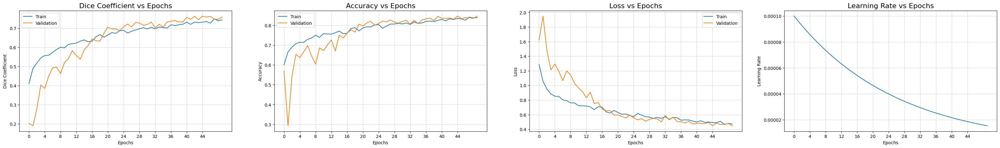

In [35]:
fig, ax = plt.subplots(1, 4, figsize=(40, 5))
ax = ax.ravel()
metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate']

for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr']):
# metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate', 'Precision', 'Recall', 'F1 Score']

# for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr', 'recall', 'precision', 'f1']):
    if met != 'lr':
        ax[i].plot(history.history[met])
        ax[i].plot(history.history['val_' + met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].legend(['Train', 'Validation'])
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
    else:
        ax[i].plot(history.history[met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")

plt.savefig('model_metrics_plot.png', facecolor= 'w',transparent= False, bbox_inches= 'tight', dpi= 150)

## Predictions

In [36]:
model.load_weights("simple_MultiUNet.h5")

In [37]:
testing_gen = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512))

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.
1/1 [==============================] - 0s 31ms/step


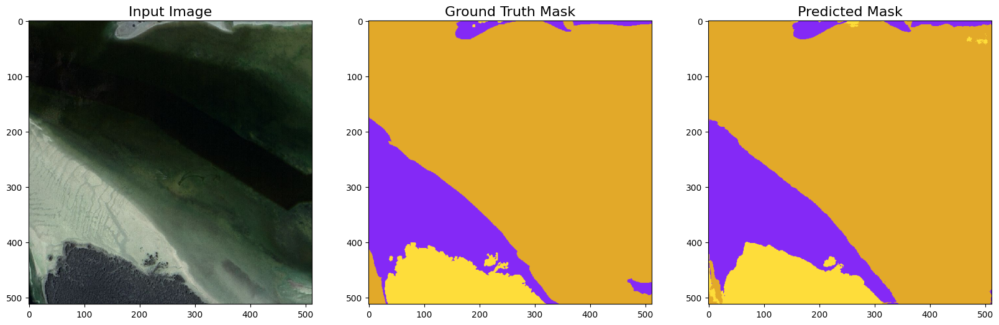

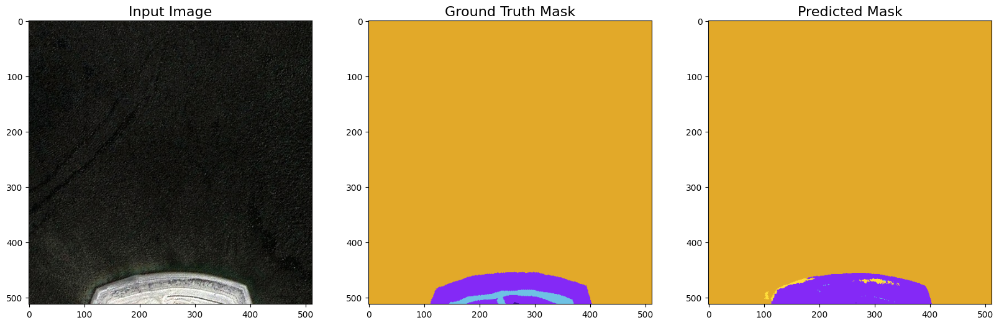

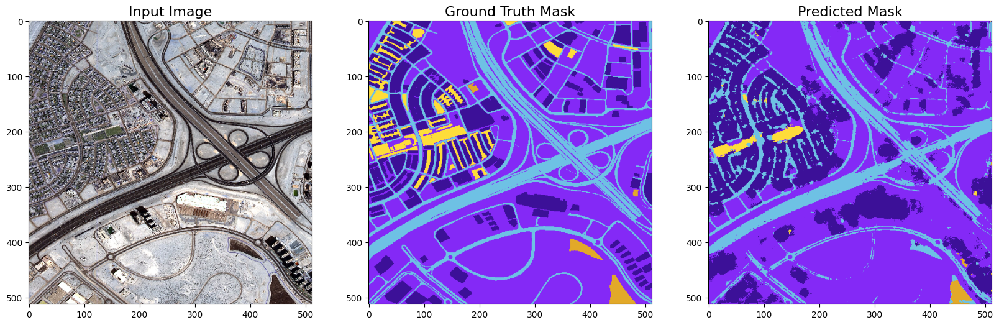

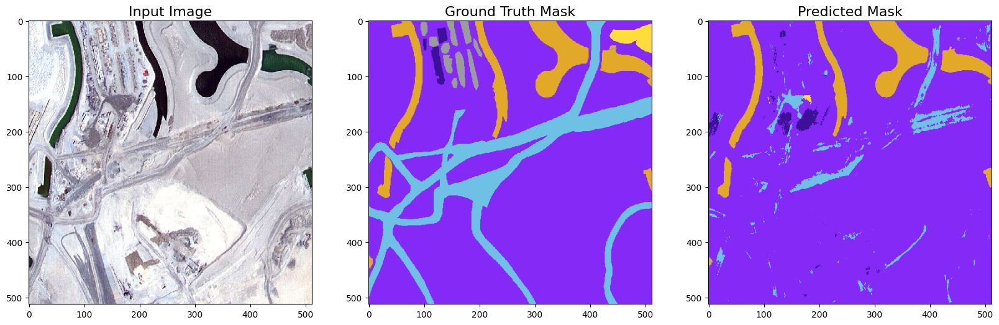

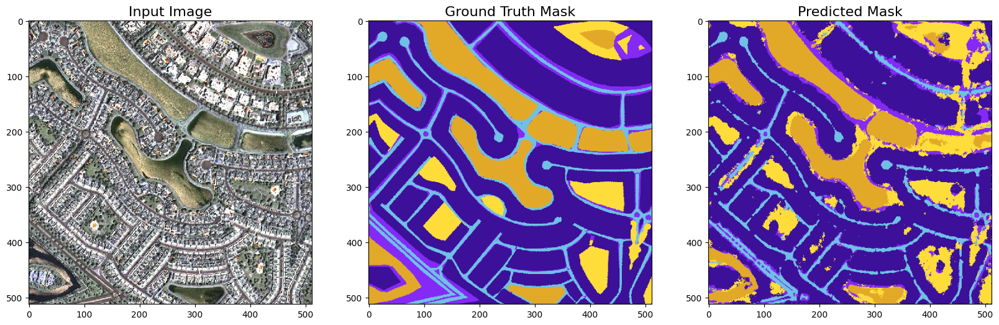

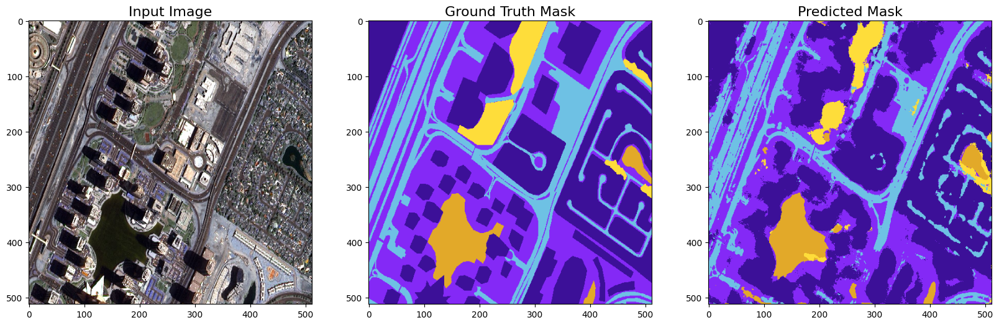

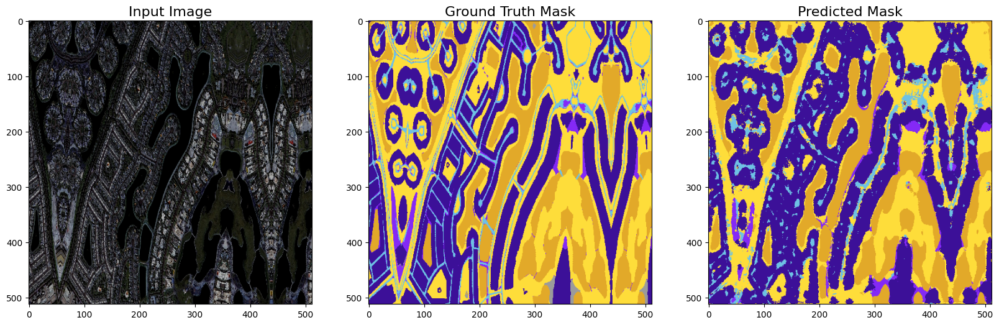

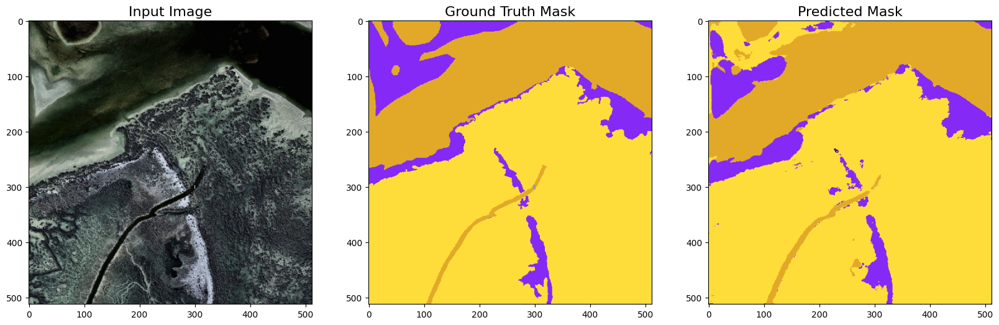

1/1 [==============================] - 0s 67ms/step


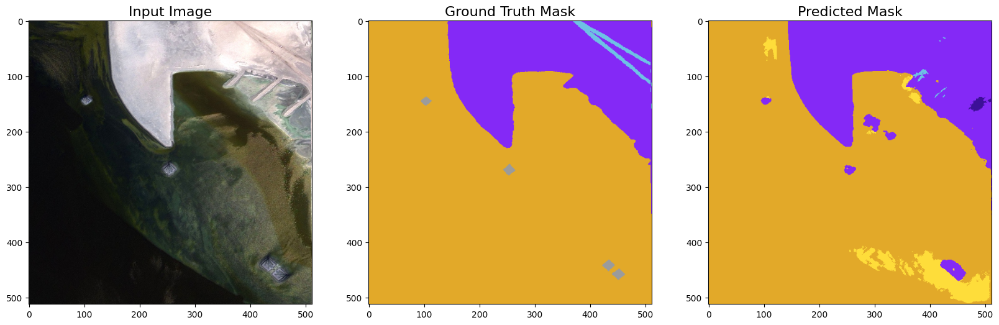

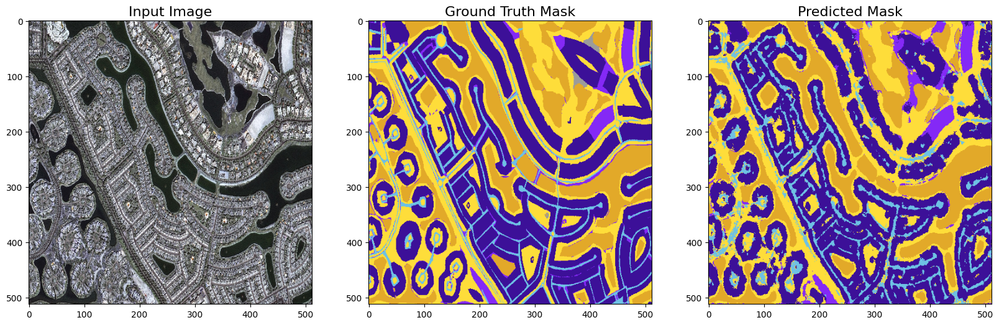

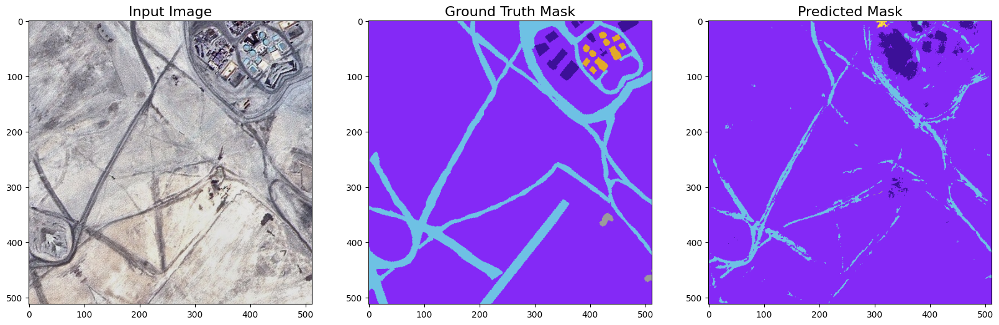

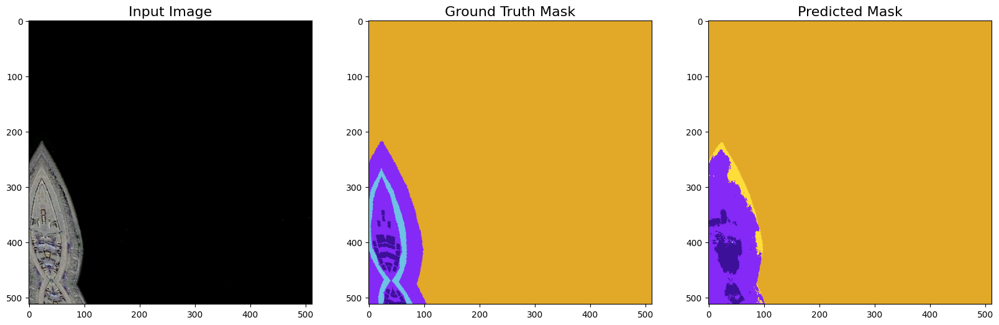

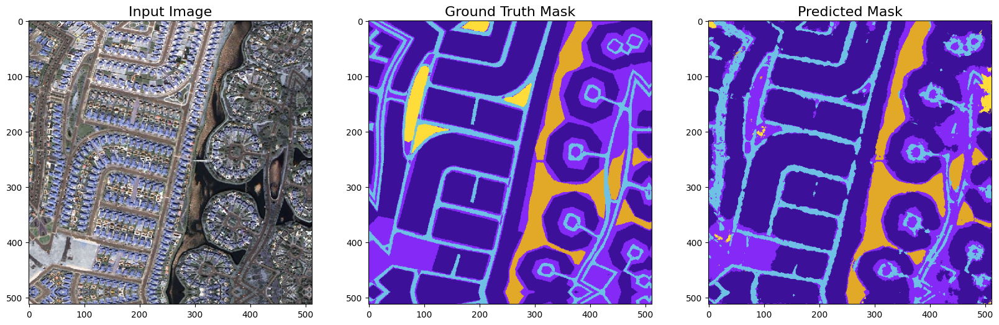

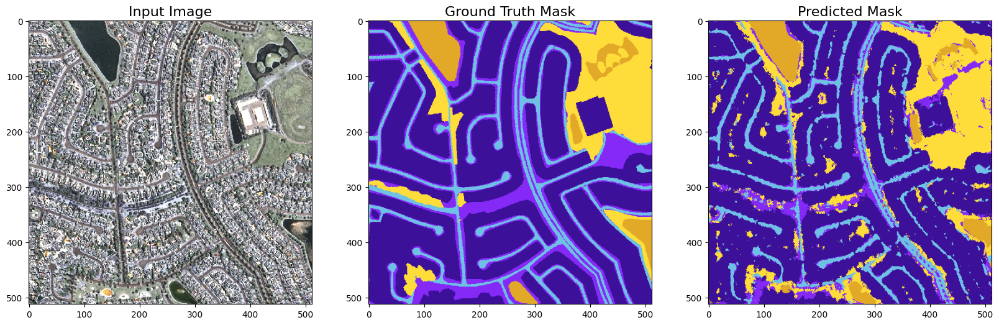

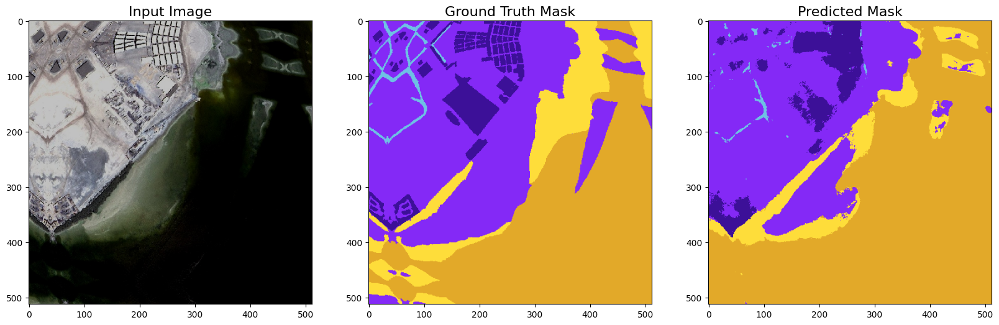

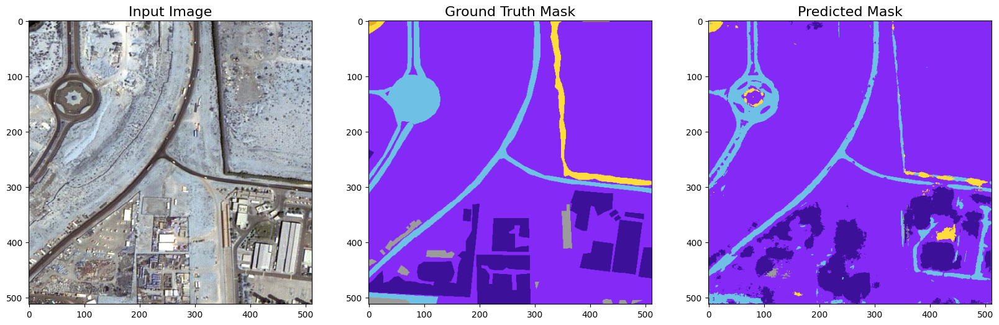

In [38]:
count = 0
for i in range(2):
    batch_img,batch_mask = next(testing_gen)
    pred_all= model.predict(batch_img)
    np.shape(pred_all)

    for j in range(0,np.shape(pred_all)[0]):
        count += 1
        fig = plt.figure(figsize=(20,8))

        ax1 = fig.add_subplot(1,3,1)
        ax1.imshow(batch_img[j])
        ax1.set_title('Input Image', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax1.grid(False)

        ax2 = fig.add_subplot(1,3,2)
        ax2.set_title('Ground Truth Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax2.imshow(onehot_to_rgb(batch_mask[j],id2code))
        ax2.grid(False)

        ax3 = fig.add_subplot(1,3,3)
        ax3.set_title('Predicted Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax3.imshow(onehot_to_rgb(pred_all[j],id2code))
        ax3.grid(False)

        plt.savefig('./prediction_{}.png'.format(count), facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 200)
        plt.show()

In [39]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_metrics(y_true, y_pred):
    # Flatten the masks
    y_true_flat = y_true.argmax(axis=-1).flatten()
    y_pred_flat = y_pred.argmax(axis=-1).flatten()

    # Compute precision, recall, and F1-score
    precision = precision_score(y_true_flat, y_pred_flat, average='macro')
    recall = recall_score(y_true_flat, y_pred_flat, average='macro')
    f1 = f1_score(y_true_flat, y_pred_flat, average='macro')

    return precision, recall, f1

# Assuming pred_all contains the predicted masks and batch_mask contains the ground truth masks
# Assuming pred_all and batch_mask are in one-hot encoded format
precision, recall, f1 = evaluate_metrics(batch_mask, pred_all)
print("Precision: {:.2f}".format(precision))
print("Recall: {:.2f}".format(recall))
print("F1-score: {:.2f}".format(f1))


Precision: 0.70
Recall: 0.64
F1-score: 0.65


## Model's Activations (Outputs) Visualization

In [40]:
# image = load_img('../input/augmented-dubai-aerial-imagery-dataset/val_images/val/image_t4_008.jpg', target_size= (512, 512))
image = load_img('/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/test_images/image_t7_005.jpg', target_size= (512, 512))
image = img_to_array(image)
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
image = preprocess_input(image)
y_hat = model.predict(image)

1/1 [==============================] - 3s 3s/step


In [41]:
layers=['conv2d', 'conv2d_4', 'conv2d_8', 'conv2d_10', 'conv2d_22', 'conv2d_28', 'conv2d_34', 'conv2d_40', 'conv2d_52', 'conv2d_61', 'conv2d_67', 'conv2d_70']

conv2d (1, 512, 512, 64) 


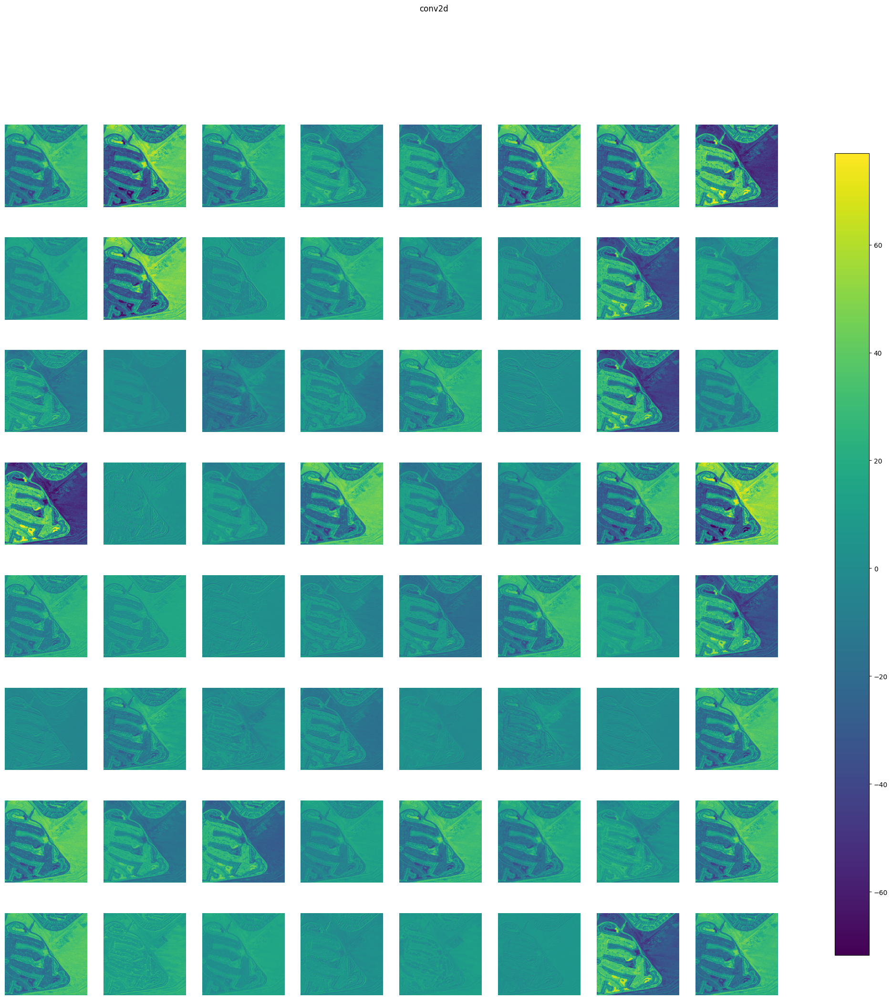

conv2d_4 (1, 32, 32, 1024) 


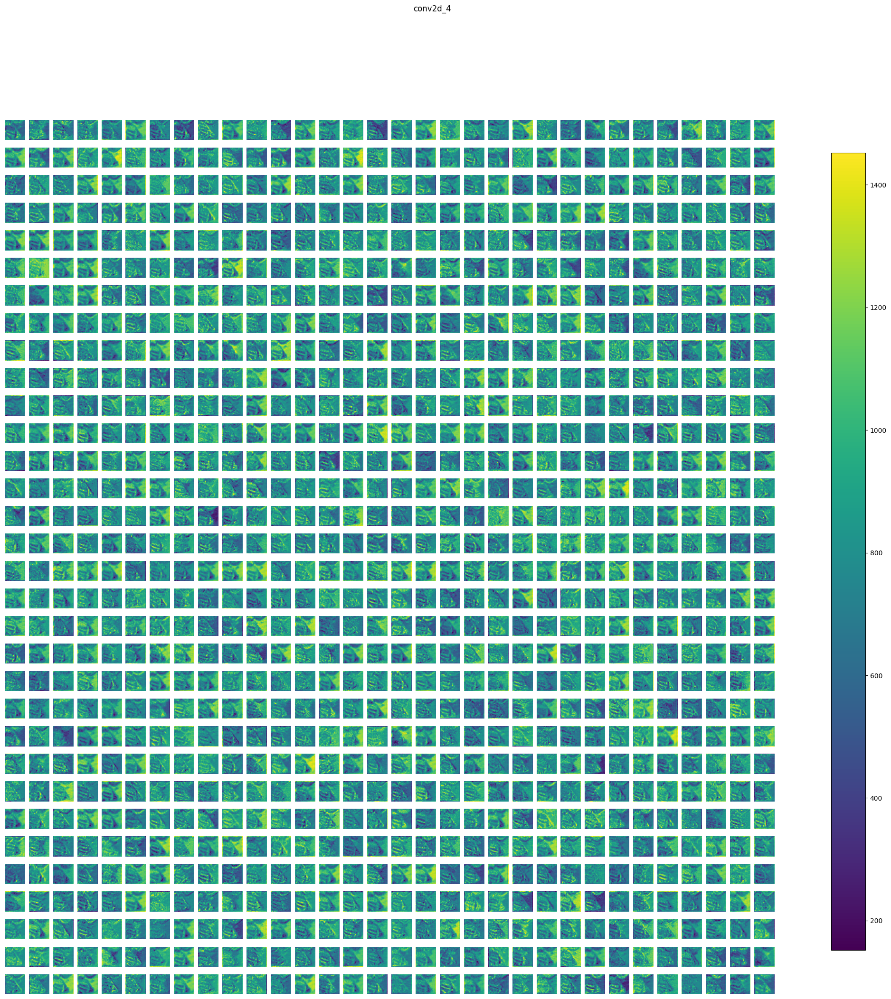

conv2d_8 (1, 128, 128, 256) 


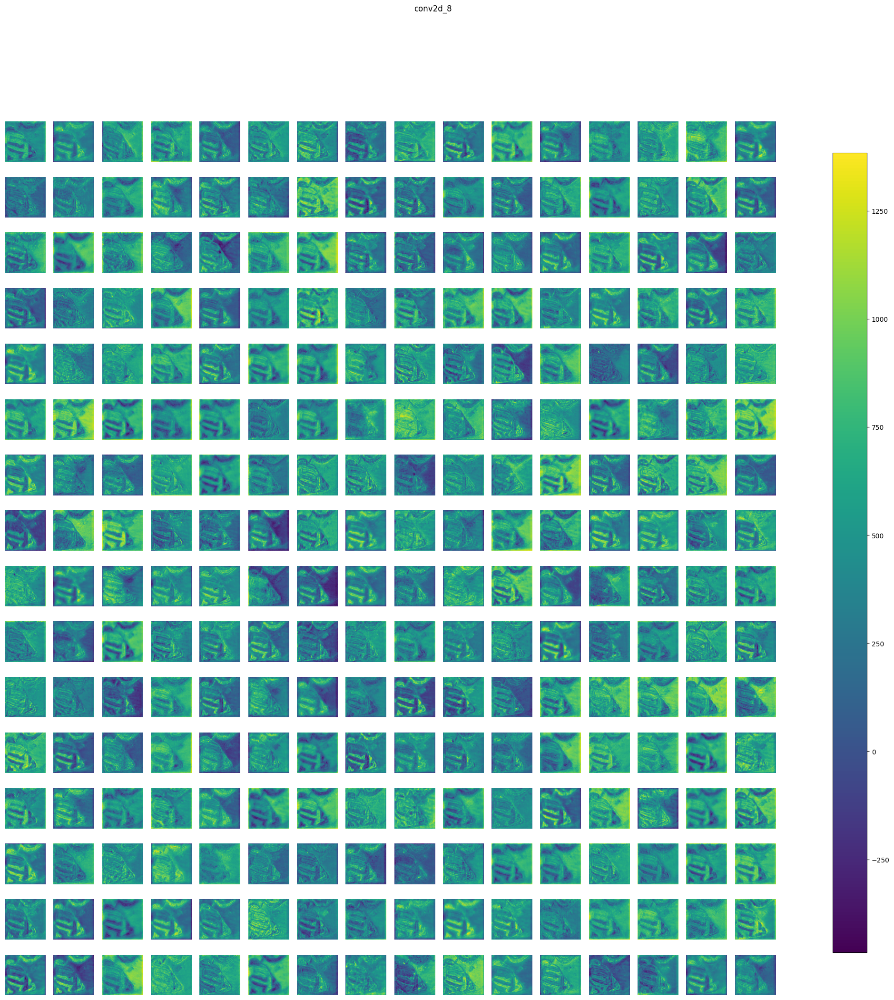

conv2d_10 (1, 256, 256, 128) 


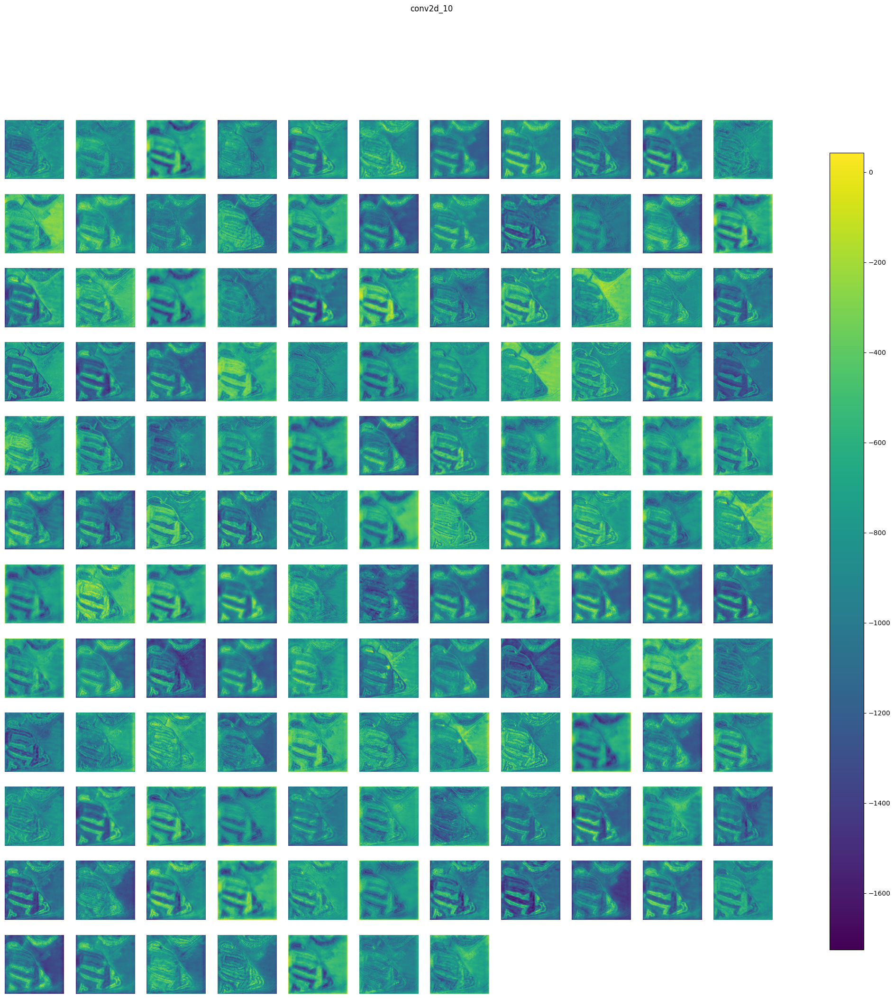

In [42]:
activations= keract.get_activations(model, image, layer_names= layers, nodes_to_evaluate= None, output_format= 'simple', auto_compile= True)
keract.display_activations(activations, cmap='viridis', save= False, directory= './activations')